In [1]:
import gbspy as g
import numpy as np
import matplotlib.pyplot as plt
import os
import h5py

import multiprocessing as mp
from matplotlib.animation import FuncAnimation
from scipy.interpolate import griddata
from mpl_toolkits.axes_grid1 import make_axes_locatable
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes
from mpl_toolkits.axes_grid1.inset_locator import mark_inset
from matplotlib.ticker import AutoMinorLocator
import matplotlib.lines as mlines
from matplotlib.ticker import AutoMinorLocator

#import sys  
#sys.path.insert(0, '/marconi/home/userexternal/klim0000/miniconda3/lib/python3.9/site-packages/gbs_python/gbspy')

# Get the current working directory|
cwd = os.getcwd()


# DN tria delta scan

#os.chdir('/marconi_scratch/userexternal/klim0000/GBS/DN_tria/delta_scan/DNT_dn0p6')
#os.chdir('/marconi_work/FUA37_TSVV2/kyungtak/GBS_DN/DN_tria/delta_scan/DPT_d0p6')

# delta-scan
#os.chdir('/marconi_scratch/userexternal/klim0000/GBS/DN_tria/delta_scan/DNT_dn0p3')
#os.chdir('/marconi_scratch/userexternal/klim0000/GBS/DN_tria/delta_scan/DNT_dn0p4')
#os.chdir('/marconi_scratch/userexternal/klim0000/GBS/DN_tria/delta_scan/DNT_dn0p5')
#os.chdir('/marconi_scratch/userexternal/klim0000/GBS/DN_tria/delta_scan/DNT_dn0p6')

# nu-scan
#os.chdir('/marconi_work/FUA37_TSVV2/kyungtak/GBS_DN/DN_tria/nu_scan/DNT_nu0p1')
#os.chdir('/marconi_work/FUA37_TSVV2/kyungtak/GBS_DN/DN_tria/nu_scan/DNT_nu1')
#os.chdir('/marconi_work/FUA37_TSVV2/kyungtak/GBS_DN/DN_tria/nu_scan/DPT_nu0p1')
os.chdir('/marconi_work/FUA37_TSVV2/kyungtak/GBS_DN/DN_tria/nu_scan/DPT_nu1')


# St scan
#os.chdir('/marconi/home/userexternal/klim0000/scratch/GBS/DN_tria/st_scan/DNT_st0p05')
#os.chdir('/marconi/home/userexternal/klim0000/scratch/GBS/DN_tria/st_scan/DNT_st0p3')
#os.chdir('/marconi/home/userexternal/klim0000/scratch/GBS/DN_tria/st_scan/DPT_st0p05')
#os.chdir('/marconi/home/userexternal/klim0000/scratch/GBS/DN_tria/st_scan/DPT_st0p3')

# Source test
#os.chdir('/marconi/home/userexternal/klim0000/scratch/GBS/DN_tria/delta_scan/PT_test')
#os.chdir('/marconi/home/userexternal/klim0000/scratch/GBS/DN_tria/delta_scan/NT_test')

# Print the current working directory
print("Current working directory: {0}".format(cwd))

# Load GBS simulations
s=g.Sim()

ModuleNotFoundError: No module named 'gbspy'

In [2]:
t2= s.time[-1] 
t1= t2 

# Entire torus
z1 = s.z[0]
z2 = s.z[-1]
iz = s.find_ind(z2, s.z)
bsign = s.attribute["B0sign"]

In [3]:
phi   = s.get_field('strmf', z1=z1, z2=z2, t1=t1, t2=t2)
psi   = s.get_field('psi', z1=z1, z2=z2, t1=t1, t2=t2)
dens  = s.get_field('n',     z1=z1, z2=z2, t1=t1, t2=t2)
theta = s.get_field('theta', z1=z1, z2=z2, t1=t1, t2=t2)
Te    = s.get_field('Te', z1=z1, z2=z2, t1=t1, t2=t2)
Ti    = s.get_field('Ti', z1=z1, z2=z2, t1=t1, t2=t2)
temperature    = s.get_field('temperature', z1=z1, z2=z2, t1=t1, t2=t2)
temperaturi    = s.get_field('temperaturi', z1=z1, z2=z2, t1=t1, t2=t2)



vpare = s.get_field('vpare', z1=z1, z2=z2, t1=t1, t2=t2)
#vparepsi = s.get_field('vparepsi', z1=z1, z2=z2, t1=t1, t2=t2)
vpari = s.get_field('vpari', z1=z1, z2=z2, t1=t1, t2=t2)
omega = s.get_field('omega', z1=z1, z2=z2, t1=t1, t2=t2)
pe    = dens * Te

phi   = s.get_field('strmf', z1=z1, z2=z2, t1=t1, t2=t2)
dens  = s.get_field('n',     z1=z1, z2=z2, t1=t1, t2=t2)
Te    = s.get_field('Te', z1=z1, z2=z2, t1=t1, t2=t2)
omega    = s.get_field('omega', z1=z1, z2=z2, t1=t1, t2=t2)
pe    = dens * Te


# Average in time and toroidal direction
dens_avg  = np.mean(dens, axis=(2,3)); dens_avg_tor = np.mean(dens, axis=2)
pe_avg  = np.mean(pe, axis=(2,3)); pe_avg_tor = np.mean(pe, axis=2)
Te_avg    = np.mean(Te, axis=(2,3)); Te_avg_tor = np.mean(Te, axis=2)

dens_fluct   = np.sqrt((dens[:,:,0,:]-dens_avg_tor)**2) / dens_avg_tor
dens_DN_fluct_avg = np.mean(dens_fluct, axis=2)

Te_fluct   = np.sqrt((Te[:,:,0,:]-Te_avg_tor)**2) / Te_avg_tor
Te_DN_fluct_avg = np.mean(Te_fluct, axis=2)


dens_avg  = np.mean(dens, axis=(2,3))
theta_avg = np.mean(theta, axis=(2,3))
Te_avg    = np.mean(Te, axis=(2,3))
temperature_avg = np.mean(temperature, axis=(2,3))
temperaturi_avg = np.mean(temperaturi, axis=(2,3))
Ti_avg    = np.mean(Ti, axis=(2,3))
pe_avg    = np.mean(pe, axis=(2,3))
vpare_avg  = np.mean(vpare, axis=(2,3))
#vparepsi_avg  = np.mean(vparepsi, axis=(2,3))
vpari_avg  = np.mean(vpari, axis=(2,3))
phi_avg    = np.mean(phi, axis=(2,3))
psi_avg    = np.mean(psi, axis=(2,3))
omega_avg    = np.mean(omega, axis=(2,3))

dens_fluct = dens[:,:,0,-1] - dens_avg
phi_fluct = phi[:,:,0,-1] - phi_avg
omega_fluct = omega[:,:,0,-1] - omega_avg
vpare_fluct = vpare[:,:,0,-1] - vpare_avg

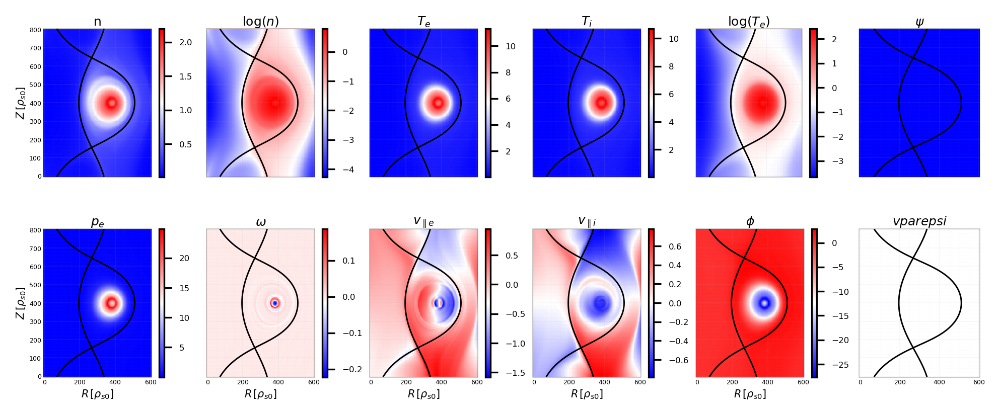

In [4]:
X, Y = np.meshgrid(s.x, s.y)
fig, ax = plt.subplots(nrows=2, ncols=6, figsize=(8, 3),  dpi=300, sharex=True, sharey=True)


cs1 = ax[0,0].pcolormesh(X, Y, dens_avg, cmap='bwr')
cs2 = ax[0,1].pcolormesh(X, Y, theta_avg, cmap='bwr')
cs3 = ax[0,2].pcolormesh(X, Y, Te_avg, cmap='bwr')
cs4 = ax[0,3].pcolormesh(X, Y, Ti_avg, cmap='bwr')
cs5 = ax[0,4].pcolormesh(X, Y, temperature_avg, cmap='bwr')

cs6 = ax[1,0].pcolormesh(X, Y, pe_avg, cmap='bwr')
cs7 = ax[1,1].pcolormesh(X, Y, omega_avg, cmap='bwr')
cs8 = ax[1,2].pcolormesh(X, Y, vpare_avg, cmap='bwr')
cs9 = ax[1,3].pcolormesh(X, Y, vpari_avg, cmap='bwr')
cs10 = ax[1,4].pcolormesh(X, Y, phi_avg, cmap='bwr')

cs11 = ax[0,5].pcolormesh(X, Y, psi_avg, cmap='bwr')
#cs12 = ax[1,5].pcolormesh(X, Y, vparepsi_avg, cmap='bwr')


divider = make_axes_locatable(ax[0,0])
cax = divider.append_axes('right', size='5%', pad=0.05)
cbar=fig.colorbar(cs1, cax=cax, orientation='vertical')
cbar.ax.tick_params(labelsize=4)

divider = make_axes_locatable(ax[0,1])
cax = divider.append_axes('right', size='5%', pad=0.05)
cbar=fig.colorbar(cs2, cax=cax, orientation='vertical')
cbar.ax.tick_params(labelsize=4)

divider = make_axes_locatable(ax[0,2])
cax = divider.append_axes('right', size='5%', pad=0.05)
cbar=fig.colorbar(cs3, cax=cax, orientation='vertical')
cbar.ax.tick_params(labelsize=4)

divider = make_axes_locatable(ax[0,3])
cax = divider.append_axes('right', size='5%', pad=0.05)
cbar=fig.colorbar(cs4, cax=cax, orientation='vertical')
cbar.ax.tick_params(labelsize=4)

divider = make_axes_locatable(ax[0,4])
cax = divider.append_axes('right', size='7%', pad=0.05)
cbar=fig.colorbar(cs5, cax=cax, orientation='vertical')
cbar.ax.tick_params(labelsize=4)

divider = make_axes_locatable(ax[1,0])
cax = divider.append_axes('right', size='5%', pad=0.05)
cbar=fig.colorbar(cs6, cax=cax, orientation='vertical')
cbar.ax.tick_params(labelsize=4)

divider = make_axes_locatable(ax[1,1])
cax = divider.append_axes('right', size='5%', pad=0.05)
cbar=fig.colorbar(cs7, cax=cax, orientation='vertical')
cbar.ax.tick_params(labelsize=4)

divider = make_axes_locatable(ax[1,2])
cax = divider.append_axes('right', size='5%', pad=0.05)
cbar=fig.colorbar(cs8, cax=cax, orientation='vertical')
cbar.ax.tick_params(labelsize=4)

divider = make_axes_locatable(ax[1,3])
cax = divider.append_axes('right', size='5%', pad=0.05)
cbar=fig.colorbar(cs9, cax=cax, orientation='vertical')
cbar.ax.tick_params(labelsize=4)

divider = make_axes_locatable(ax[1,4])
cax = divider.append_axes('right', size='5%', pad=0.05)
cbar=fig.colorbar(cs10, cax=cax, orientation='vertical')
cbar.ax.tick_params(labelsize=4)


for i in range(2):
    for j in range(6):
        ax[i,j].contour(X, Y, s.Psi, levels=[s.Psi[s.iyxpt, s.ixxpt]], linewidths=0.7, colors='k')
        ax[i,j].grid(True, which='major', alpha=1., linestyle=':', linewidth=0.1)
        ax[i,j].grid(True, which='minor', alpha=0.2, linestyle=':', linewidth=0.1)
        ax[i,j].xaxis.set_minor_locator(AutoMinorLocator())
        ax[i,j].yaxis.set_minor_locator(AutoMinorLocator())
        ax[i,j].tick_params(axis='x', labelsize=3, pad=1)
        ax[i,j].tick_params(axis='y', labelsize=3, pad=1)
        ax[i,j].tick_params(which='minor', direction="in", size=0)
        ax[i,j].tick_params(which='major', direction="in", size=0)
        ax[i,j].spines["bottom"].set_linewidth(0.1)
        ax[i,j].spines["left"].set_linewidth(0.1)
        ax[i,j].spines["right"].set_linewidth(0.1)
        ax[i,j].spines["top"].set_linewidth(0.1)
        
        
ax[1,0].set_xlabel(r'$R \,[\rho_{s0}]$', fontsize=5, labelpad=1)
ax[1,1].set_xlabel(r'$R \,[\rho_{s0}]$', fontsize=5, labelpad=1)
ax[1,2].set_xlabel(r'$R \,[\rho_{s0}]$', fontsize=5, labelpad=1)
ax[1,3].set_xlabel(r'$R \,[\rho_{s0}]$', fontsize=5, labelpad=1)
ax[1,4].set_xlabel(r'$R \,[\rho_{s0}]$', fontsize=5, labelpad=1)

ax[0,0].set_ylabel(r'$Z\, [\rho_{s0}]$', fontsize=5, rotation=90, labelpad=1)
ax[1,0].set_ylabel(r'$Z\, [\rho_{s0}]$', fontsize=5, rotation=90, labelpad=1)

ax[0,0].set_title(r'n', fontsize=6, pad=1.5)
ax[0,1].set_title(r'$\log (n)$', fontsize=6, pad=1.5)
ax[0,2].set_title(r'$T_e$', fontsize=6, pad=1.5)
ax[0,3].set_title(r'$T_i$', fontsize=6, pad=1.5)
ax[0,4].set_title(r'$\log (T_e)$', fontsize=6, pad=1.5)
ax[0,5].set_title(r'$\psi$', fontsize=6, pad=1.5)

ax[1,0].set_title(r'$p_e$', fontsize=6, pad=1.5)
ax[1,1].set_title(r'$\omega$', fontsize=6, pad=1.5)
ax[1,2].set_title(r'$v_{\parallel e}$', fontsize=6, pad=1.5)
ax[1,3].set_title(r'$v_{\parallel i}$', fontsize=6, pad=1.5)
ax[1,4].set_title(r'$\phi$', fontsize=6, pad=1.5)
ax[1,5].set_title(r'$vparepsi$', fontsize=6, pad=1.5)

#plt.gca().set_aspect('equal')
plt.show(block=False)

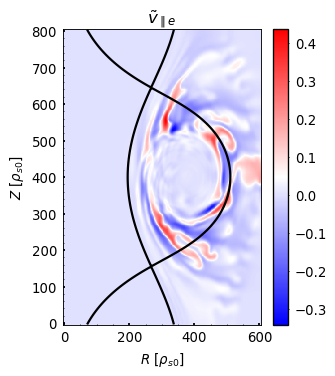

In [8]:
fig, ax = plt.subplots(figsize=(4, 4.8), dpi=80)  # Increased figure size
X,Y = np.meshgrid(s.x, s.y)

import matplotlib.colors as mcolors
#vmax = 0.01 #np.max(np.abs(dens_fluct))
#norm = mcolors.TwoSlopeNorm(vmin=-vmax, vcenter=0, vmax=vmax)

# Create the plot with the custom normalization
cs = ax.pcolormesh(X, Y, dens_fluct, cmap='bwr') 
#cs = ax.pcolormesh(X, Y, dens_DN_fluct_avg, cmap='bwr') 
#cs = ax.pcolormesh(X, Y, phi_fluct, cmap='bwr', vmin=-2, vmax=2)
#cs = ax.pcolormesh(X, Y, vpare_fluct, vmin=-1, vmax=1, cmap='bwr') 
cbar = fig.colorbar(cs)

cbar.ax.tick_params(labelsize=12, size=1, pad=5) 
cbar.outline.set_linewidth(1.2)

# Plot Separatrix
ax.contour(X, Y, s.Psi, levels=[s.Psi[s.iyxpt, s.ixxpt]], colors='k', linewidths=2)

ax.xaxis.set_minor_locator(AutoMinorLocator())
ax.yaxis.set_minor_locator(AutoMinorLocator())
ax.tick_params(which='minor', direction="in", size=0.8, width=0.8)
ax.tick_params(which='major', direction="in", size=2, width=1.6)
ax.tick_params(axis='x', labelsize=12, pad=5)
ax.tick_params(axis='y', labelsize=12, pad=5)
ax.yaxis.get_offset_text().set_fontsize(10)
ax.set_xlabel(r'$R\,\,[\rho_{s0}]$', fontsize=12, labelpad=5)
ax.set_ylabel(r'$Z\,\,[\rho_{s0}]$', fontsize=12, rotation=90, labelpad=5)
#ax.set_title(r'$\tilde{n}/\bar{n}$', fontsize=15, pad=5)
ax.set_title(r'$\tilde{v}_{\parallel e}$', fontsize=15, pad=5)

for spine in ['top', 'right', 'bottom', 'left']:
    ax.spines[spine].set_linewidth(0.8)

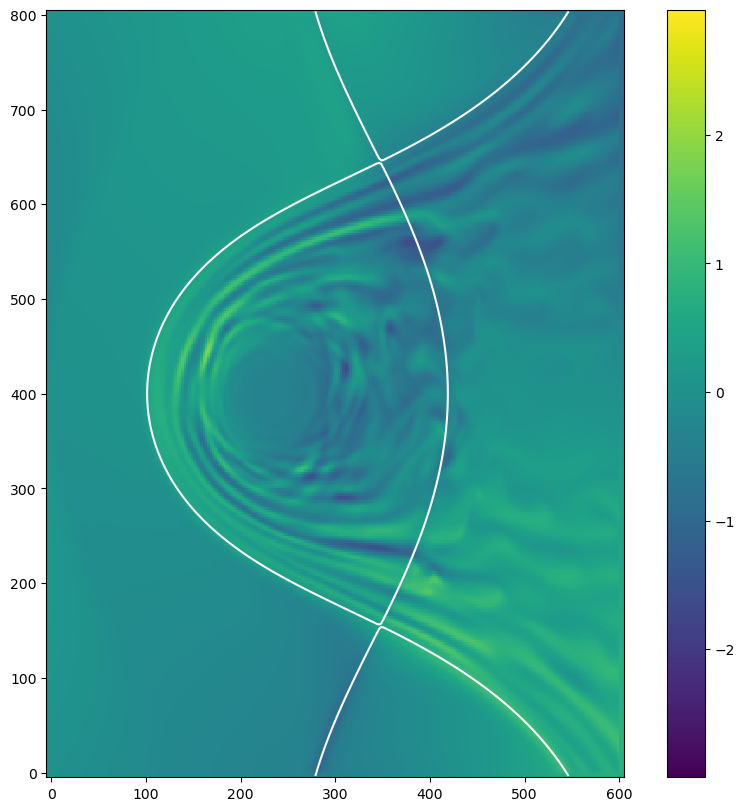

Animation size has reached 21145985 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [7]:
# Python Movie HTML script
from IPython.display import HTML
ani = g.movie(s, "vpare", t1=s.time[0], t2=s.time[-1])#s.time[-1])
# Wrap the animation in a div and use CSS to scale it
scaling_factor = 0.1 # For example, to scale to 50% of the original size
html_code = f"""
<div style="transform: scale({scaling_factor}); transform-origin: top left;">
    {ani.to_jshtml()}
</div>
"""
HTML(ani.to_jshtml())